In [24]:
#Load in CSV
#Redefine to relevant columns: location, time, NO2 measurement, PM2.5 measurement
#Hypothesise measurements
#Define relationship between NO2/PM2.5 levels and heart rate, performance based on real data
#Create dummy heart rate/performance data based on this.

#Could run analysis on whether prolonged exposure to higher pollution levels affects performance, regardless of the CURRENT measurements. This would be location based.
#How does pollution levels affect heart rate. What are the real life-effects of higher average heart rates?
#What areas had the greatest pollution rates, are these urban or suburban, can you tell from NO2 rates which are generally traffick orientated?
#What times did the pollution rates generally spike/plummet? How did the two pollutants differ in this regard?

In [25]:
#Load in CSV
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Read the CSV file into a DataFrame
df_orig = pd.read_csv('/content/drive/MyDrive/Air Aware Interview Assignment/stationary_data.csv')
df = df_orig.copy()
#df[["date","utc"]] = df["date_utc"].str.split(' ', expand=True)
df = df[["location_name", "latitude", "longitude", "date_utc", "pm2_5_ugm3", "no2_ugm3"]]

#Hypothesise pollutant measurements, make self-generating.
df_hypo = df_hypo.dropna() #Brief is to create realistic but imperfect dataset, so let's just drop rows with missing data.

def addNoise(dataSet, columnName):
  # Extract summary statistics
  mean_col = dataSet[columnName].mean()
  std_col = dataSet[columnName].std()
  #print(mean_col)
  #print(std_col)
  # Generate hypothetical NO2 data by adding noise
  np.random.seed(42)
  return dataSet[columnName] + np.random.normal(0, std_col * 0.5, len(dataSet))

df_hypo = df.copy()
df_hypo['pm2_5_ugm3'] = addNoise(df, 'pm2_5_ugm3')
df_hypo['no2_ugm3'] = addNoise(df, 'no2_ugm3')

#Get rid of zeros, bring to min from original dataset
df_hypo.loc[df_hypo["pm2_5_ugm3"]<0, "pm2_5_ugm3"] = np.min(df["pm2_5_ugm3"])
df_hypo.loc[df_hypo["no2_ugm3"]<0, "no2_ugm3"] = np.min(df["no2_ugm3"])

#DEALING WITH NULLS
187274/757357 #25% of the pm2 measurements are nulls.
102095/757357 #13% of the no2 measurements are nulls (and therefore biometrics too)


##Define relationship between NO2/PM2.5 levels and heart rate, performance based on real data
## NEED TO REFINE THESE.
#Next we need to enrich this data with heart rate, performance, and other bits.
#Apply functions to simulate heart rate, respiratory rate, and running pace based on NO₂ exposure.

from scipy.stats import norm
import math

def simulate_heart_rate(no2):
    """Simulate heart rate affected by pollution (normal range: 60-180 bpm)."""
    if math.isnan(no2):
      return no2
    base_hr = np.random.normal(70, 10)  # Resting HR
    pollution_effect = (no2 / 100) * 10  # Small HR increase with pollution
    return min(180, base_hr + pollution_effect)

def simulate_respiratory_rate(no2):
    """Simulate respiratory rate (normal range: 12-25 breaths/min)."""
    if math.isnan(no2):
      return no2
    base_rr = np.random.normal(16, 2)
    pollution_effect = (no2 / 100) * 3  # Increased respiratory effort
    return min(25, base_rr + pollution_effect)

def simulate_running_pace(no2):
    """Simulate running pace (min/km), slower under high NO2."""
    if math.isnan(no2):
      return no2
    base_pace = np.random.normal(6, 0.3)  # Normal pace ~6:00 min/km
    pollution_effect = (no2 / 100) * 0.3  # Running slows down with pollution
    return max(5, base_pace + pollution_effect)  # Ensure realistic values

# Apply functions to generate new columns
df_hypo["heart_rate"] = df_hypo["no2_ugm3"].apply(simulate_heart_rate)
df_hypo["respiratory_rate"] = df_hypo["no2_ugm3"].apply(simulate_respiratory_rate)
df_hypo["running_pace"] = df_hypo["no2_ugm3"].apply(simulate_running_pace)

# Save new dataset
#df_hypo.to_csv("hypothetical_no2_health_data.csv", index=False)

# Display sample
df_hypo.head()

df_hypo["location_name"].unique()
#Peckham Road (SE), Savernake Road (NW), Tower Bridge Road (Centre), National Physical Laboratory (South of Twickenham so surely less pollution)
#Seem like sensible places to limit ourselves to
#All data taken from hypo now.

df_peckham = df_hypo.loc[df['location_name'] == 'Peckham Road']
df_savernake = df_hypo.loc[df['location_name'] == 'Savernake Road']
df_tower = df_hypo.loc[df['location_name'] == 'Tower Bridge Road']
df_lab = df_hypo.loc[df['location_name'] == 'National Physical Laboratory']

#print(df_peckham.count(), df_savernake.count(), df_tower.count(), df_lab.count())
#All similar data points

<ipython-input-25-39cb97a495bf>:7: DtypeWarning: Columns (7) have mixed types. Specify dtype option on import or set low_memory=False.
  df_orig = pd.read_csv('/content/drive/MyDrive/Air Aware Interview Assignment/stationary_data.csv')


,no2_ugm3
location_name,
Albert Street,34.596943
Ballance Road,39.468632
Beaumont Grove,34.256546
Black Horse Court,34.153839
Blackfriars Road,33.447039
...,...
Wandsworth Road,37.586113
West Smithsfield,38.435815
Whitehall,53.614313


In [26]:
########## Next we'll analyse the data. Avoid answering questions on how pollutants affect biometrics for now as we defined the relationship, we know the answer
#Maybe that's what they want though to just show you can show it?
#1. Identify key patterns, trends, or correlations (e.g., pollution peaks, low-pollution routes, or health impacts)

# Check for missing values
print("Count nulls")
print(df_hypo.isnull().sum())

# Check basic statistics
print("HYPO: Summary stats")
print(df_hypo.describe())
print("REAL: Summary stats")
print(df.describe())

# Detect anomalies (e.g., unrealistic heart rate) DATA IMPERFECT SO LEAVE IT.
print("Detect anomolies")
len(df_hypo[(df_hypo["heart_rate"] < 40) | (df_hypo["heart_rate"] > 200)]) / 495138
495138/757357

Count nulls
location_name       0
latitude            0
longitude           0
date_utc            0
pm2_5_ugm3          0
no2_ugm3            0
heart_rate          0
respiratory_rate    0
running_pace        0
dtype: int64
HYPO: Summary stats
            latitude      longitude     pm2_5_ugm3       no2_ugm3  \
count  495138.000000  495138.000000  495138.000000  495138.000000   
mean       51.513965      -0.110553      11.927298      38.248718   
std         0.048174       0.106060      12.692056      23.199718   
min        51.362842      -0.359770       0.000021       0.000472   
25%        51.485597      -0.174732       3.899376      22.885161   
50%        51.514071      -0.114098       9.125874      34.370693   
75%        51.544414      -0.061823      15.606707      48.988159   
max        51.673753       0.211820     333.174903     578.086379   

          heart_rate  respiratory_rate   running_pace  
count  495138.000000     495138.000000  495138.000000  
mean       73.800800   

0.6537709428974711

In [54]:
D = df_hypo.groupby("location_name")["no2_ugm3"].mean()
#plt.plot(D, marker ="x")

#Find list of places over 40 recommended annual mean

len(D.loc[D>40]) #27

27

We see min and maxes occur at 4Am and 8Am resp. Rush hour. 
      pm2_5_ugm3  no2_ugm3
hour                      
4      13.632095   29.6146
      pm2_5_ugm3   no2_ugm3
hour                       
8      13.765318  44.666894
When we sort based on NO2 levels, we see lowest measurements take place at 3, 4, 5 am. Highest at 8, second highest at 9am, but third biggest spike at 22:00 and sustained high
      pm2_5_ugm3   no2_ugm3
hour                       
4      13.632095  29.614600
3      13.406611  30.125600
5      13.887665  31.040561
2      13.223917  32.344092
14      9.348520  33.808663
13      9.925108  34.854275
15      9.321153  34.950780
6      14.089102  35.979022
12     10.467969  36.049750
1      13.031506  36.100456
16      9.319247  36.315804
11     11.206489  38.323191
17      9.550412  38.507326
0      12.921190  39.310594
18     10.001189  41.179398
10     12.284461  41.580249
7      14.113656  42.062653
23     12.784929  42.065692
19     10.680174  43.138648
20     11.4

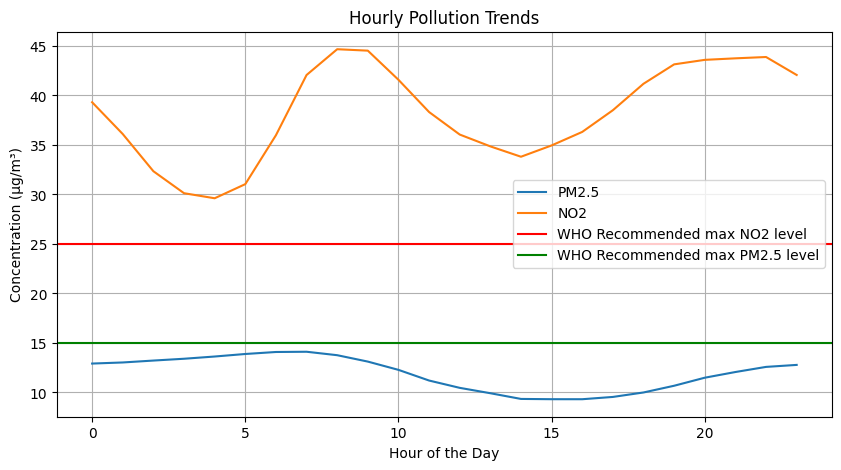

In [27]:
#### Analyze daily/hourly variations

# Convert 'date' to datetime format
df_hypo["date_utc"] = pd.to_datetime(df_hypo["date_utc"])
df_hypo["date"] = df_hypo["date_utc"].dt.date

# Group by hour of the day to see daily patterns
df_hypo["hour"] = df_hypo["date_utc"].dt.hour
hourly_avg = df_hypo.groupby("hour")[["pm2_5_ugm3", "no2_ugm3"]].mean()
print("We see min and maxes occur at 4Am and 8Am resp. Rush hour. ")
print(hourly_avg.loc[hourly_avg["no2_ugm3"]==np.min(hourly_avg["no2_ugm3"])])
print(hourly_avg.loc[hourly_avg["no2_ugm3"]==np.max(hourly_avg["no2_ugm3"])])
print("When we sort based on NO2 levels, we see lowest measurements take place at 3, 4, 5 am. Highest at 8, second highest at 9am, but third biggest spike at 22:00 and sustained high")
print(hourly_avg.sort_values(by="no2_ugm3"))


# Plot pollution variation over a 24-hour period
plt.figure(figsize=(10, 5))
plt.plot(hourly_avg.index, hourly_avg["pm2_5_ugm3"], label="PM2.5")
plt.plot(hourly_avg.index, hourly_avg["no2_ugm3"], label="NO2")
plt.axhline(y=25, color='r', linestyle='-', label="WHO Recommended max NO2 level") #24-hour mean: The WHO recommends that the 24-hour mean concentration of NO2 should not exceed 25 µg/m
plt.axhline(y=15, color= 'g',linestyle='-', label="WHO Recommended max PM2.5 level") #The WHO air quality guideline (AQG) states that annual average concentrations of PM2.5 should not exceed 5 µg/m3, while 24-hour average exposures should not exceed 15 µg/m3 more than 3 - 4 days per year.

plt.xlabel("Hour of the Day")
plt.ylabel("Concentration (µg/m³)")
plt.legend()
plt.title("Hourly Pollution Trends")
plt.grid()
plt.show()

#We clearly see NO2 spike

In [27]:
#### Analyze MONTHLY, need to update this

# Convert 'date' to datetime format
df_hypo["date_utc"] = pd.to_datetime(df_hypo["date_utc"])
df_hypo["date"] = df_hypo["date_utc"].dt.date

# Group by hour of the day to see daily patterns
df_hypo["hour"] = df_hypo["date_utc"].dt.hour
hourly_avg = df_hypo.groupby("hour")[["pm2_5_ugm3", "no2_ugm3"]].mean()
print("We see min and maxes occur at 4Am and 8Am resp. Rush hour. ")
print(hourly_avg.loc[hourly_avg["no2_ugm3"]==np.min(hourly_avg["no2_ugm3"])])
print(hourly_avg.loc[hourly_avg["no2_ugm3"]==np.max(hourly_avg["no2_ugm3"])])
print("When we sort based on NO2 levels, we see lowest measurements take place at 3, 4, 5 am. Highest at 8, second highest at 9am, but third biggest spike at 22:00 and sustained high")
print(hourly_avg.sort_values(by="no2_ugm3"))


# Plot pollution variation over a 24-hour period
plt.figure(figsize=(10, 5))
plt.plot(hourly_avg.index, hourly_avg["pm2_5_ugm3"], label="PM2.5")
plt.plot(hourly_avg.index, hourly_avg["no2_ugm3"], label="NO2")
plt.axhline(y=25, color='r', linestyle='-', label="WHO Recommended max NO2 level") #24-hour mean: The WHO recommends that the 24-hour mean concentration of NO2 should not exceed 25 µg/m
plt.axhline(y=15, color= 'g',linestyle='-', label="WHO Recommended max PM2.5 level") #The WHO air quality guideline (AQG) states that annual average concentrations of PM2.5 should not exceed 5 µg/m3, while 24-hour average exposures should not exceed 15 µg/m3 more than 3 - 4 days per year.

plt.xlabel("Hour of the Day")
plt.ylabel("Concentration (µg/m³)")
plt.legend()
plt.title("Hourly Pollution Trends")
plt.grid()
plt.show()

#We clearly see NO2 spike

     pm2_5_ugm3   no2_ugm3
day                       
6     12.377311  33.358989
5     11.775966  35.357852
0     12.163406  38.600253
4     11.536436  38.974902
2     11.202357  39.493185
3     11.967129  40.097437
1     12.475208  41.972250


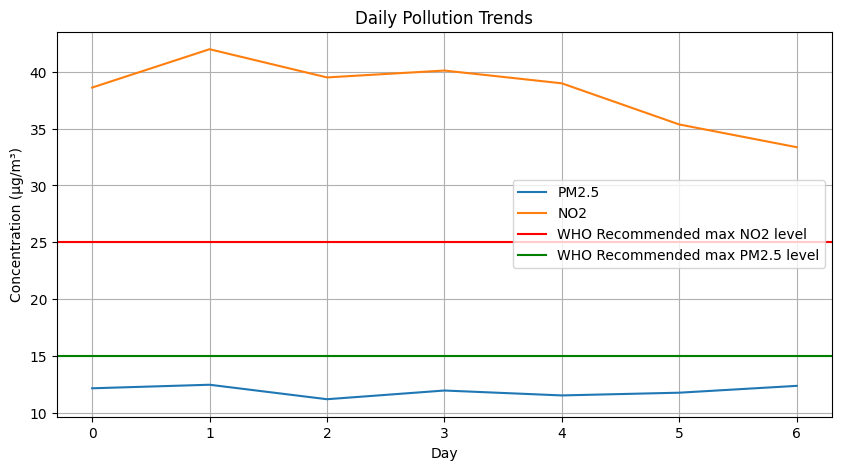

In [28]:
import datetime
import calendar

df_hypo['day'] = df_hypo['date'].apply(lambda x: datetime.datetime.strptime(str(x), '%Y-%m-%d').weekday())
df_hypo.head(20) #4 corresponds to Friday. Therefore Monday is 0.

daily_avg = df_hypo.groupby("day")[["pm2_5_ugm3", "no2_ugm3"]].mean()
#Highest NO2 generally on Tuesdays, with lowest values and signifignt drop at weekend.
print(daily_avg.sort_values(by="no2_ugm3"))

# Plot pollution variation over a 24-hour period
plt.figure(figsize=(10, 5))
plt.plot(daily_avg.index, daily_avg["pm2_5_ugm3"], label="PM2.5")
plt.plot(daily_avg.index, daily_avg["no2_ugm3"], label="NO2")
plt.axhline(y=25, color='r', linestyle='-', label="WHO Recommended max NO2 level") #24-hour mean: The WHO recommends that the 24-hour mean concentration of NO2 should not exceed 25 µg/m
plt.axhline(y=15, color= 'g',linestyle='-', label="WHO Recommended max PM2.5 level") #The WHO air quality guideline (AQG) states that annual average concentrations of PM2.5 should not exceed 5 µg/m3, while 24-hour average exposures should not exceed 15 µg/m3 more than 3 - 4 days per year.

plt.xlabel("Day")
plt.ylabel("Concentration (µg/m³)")
plt.legend()
plt.title("Daily Pollution Trends")
plt.grid()
plt.show()

In [29]:
#GEOSPATIAL ANALYSIS: Finding Low/High-Pollution Routes

import folium
from folium.plugins import HeatMap

# Create a map centered on the average location
m = folium.Map(location=[df_hypo["latitude"].mean(), df_hypo["longitude"].mean()], zoom_start=12)

# Add heatmap for NO₂ pollution
heat_data = df_hypo[["latitude", "longitude", "no2_ugm3"]].values.tolist()
HeatMap(heat_data, radius=20).add_to(m)

# Save and display
m.save("pollution_heatmap.html")
m

#